# Much Simpler Algorithm for Lambertian Photometric Stereo

In [1]:
# Imports
import matplotlib.pyplot as plt
import cv2
import glob
import os
import numpy as np

# Make figure resolution higher
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

In [5]:
# Reading in images
def imread(file_name, intensities=None, normalize=False, flag=-1, scale=1.0):
    img_names = glob.glob(file_name) # Get all of a certain file type that matches file_name
    img_list = []
    if len(img_names) == 0:
        print("[No {} images]".format(file_name))
        exit()
    img_names = sorted(img_names)
    for i, path in enumerate(img_names):
        im = cv2.imread(path, flag)
        img = cv2.resize(im, None, fx=scale, fy=scale) # Read in image
        # Normalize if needed (in this case since it's images of the moon it's almost grayscale so it doesn't make much of a difference anyway)
        if np.any(intensities):
            img = img / intensities[i]
        elif normalize:
            img = img / 255.0
        # img = img.reshape((-1, 1)).squeeze(1)
        img_list.append(img)
    return img_list

In [6]:
from numpy import loadtxt

dataPath = "test_data/"
object = []
for obj in (os.listdir(dataPath)):
    object.append(obj)

L_direction = loadtxt(f"./light_directions.txt") # Load in the light directions

imgs = imread(f"./test_data_libration/*_resized.jpg", intensities=None, normalize=False)

In [7]:
# Shouldn't really change anything
for i, img in enumerate(imgs):
    imgs[i] = cv2.bitwise_and(img, img, mask=None)
    i += 1

# imgs = np.array(imgs, dtype=np.uint8)[:, :, 0]
imgs = np.array(imgs, dtype=np.uint8)

In [16]:
from sklearn.preprocessing import normalize
# Actual photometric stereo algorithm (kinda complicated but I think I get it)
# Uses pseudoinverse to solve for the surface normals and albedos
def photometric_stereo(imgs, L_list):
    """
    Perform photometric stereo using multiple images of an object captured under different light sources.

    Parameters
    ----------
    imgs: np.ndarray
        Numpy array containing all the images of the object taken with different light sources.
    L_list: list
        List of light source directions (vectors with 3 positional elements x, y, z) for each image.

    Returns
    -------
    img_normal: np.ndarray
        Computed surface normals of the object.
    img_albedo: np.ndarray
        Computed albedos (reflectance) of the object.
    img_normal_rgb: np.ndarray
        RGB representation of the surface normals for visualization.
    """

    # Convert L_list to a numpy array for easier manipulation
    L = np.array(L_list)
    # Transpose the array
    Lt = L.T

    # Get the height and width of the first image in the set
    h, w = imgs[0].shape[:2]

    # Initialize arrays for storing computed values
    img_normal = np.zeros((h, w, 3))
    img_albedo = np.zeros((h, w, 3))
    I = np.zeros((len(L_list), 3))
    I_gray = np.zeros(len(L_list))
    normals = np.zeros((h, w, 3))

    # Iterate over each pixel in the images
    for x in range(w):
        for y in range(h):
            # Collect intensity values for each image at the current pixel
            for i in range(len(imgs)):
                I[i] = imgs[i][y][x]
                gray_img = cv2.cvtColor(imgs[i], cv2.COLOR_BGR2GRAY)
                I_gray[i] = gray_img[y][x]

            # Compute surface normals and albedos using photometric stereo equations
            tmp1 = np.linalg.inv(np.dot(Lt, L)) # Psuedoinverse
            tmp2 = np.dot(Lt, I)
            N = np.dot(tmp1, tmp2).T
            # print(N)
            # N = np.dot(np.linalg.inv(np.dot(Lt, L)), np.dot(Lt, I)).T
            rho = np.linalg.norm(N, axis=1)
            img_albedo[y][x] = rho

            # Convert surface normals to grayscale and normalize
            N_gray = N[0] * 0.2989 + N[1] * 0.5870 + N[2] * 0.1140
            Nnorm = np.linalg.norm(N)
            if Nnorm == 0:
                continue
            img_normal[y][x] = N_gray / Nnorm
            normals[y][x] = np.dot(np.linalg.inv(np.dot(Lt, L)), np.dot(Lt, I_gray)).T

    # Convert the computed values for visualization
    img_normal_rgb = ((img_normal * 0.5 + 0.5) * 255).astype(np.uint8)
    # img_normal_rgb = cv2.cvtColor(img_normal_rgb, cv2.COLOR_BGR2RGB) # Recolor from the BGR cv2 uses to RGB
    img_albedo = (img_albedo / np.max(img_albedo) * 255).astype(np.uint8)
    img_normal_rgb_2 = ((normals * 0.5 + 0.5) * 255).astype(np.uint8)

    return img_normal, img_albedo, img_normal_rgb, normals, img_normal_rgb_2
    # N = normalize(np.linalg.lstsq(L, imgs, rcond=-1)[0].T, axis=1)
    # return N

In [17]:
# imgs[:, :, 0].shape

In [18]:
# normal = photometric_stereo(imgs, L_direction)
# normal

In [19]:
# N.shape

In [20]:
# N = np.reshape(normal.copy()[:, 0],(730, 730, 3))
# N2 = N.copy()
# N2[:,:,0], N2[:,:,2] = N2[:,:,2], N2[:,:,0].copy()
# N2 = (N2 + 1.0) / 2.0
# result = N2
# # result.shape
# plt.imshow(result)

In [21]:
# # Write N to a text file
# np.savetxt("N.txt", N.reshape((730 ** 2, 3)))
# # plt.imshow(N)

In [22]:
img_normal, img_albedo, img_normal_rgb, normals, img_normal_rgb_2 = photometric_stereo(imgs, L_direction)
cv2.imwrite(f"./output/normal_rgb.png", cv2.cvtColor(img_normal_rgb, cv2.COLOR_RGB2BGR))
cv2.imwrite(f"./output/albedo.png", img_albedo)
cv2.imwrite(f"./output/normal_rgb_2.png", img_normal_rgb_2)
np.save(f"./output/normals.npy", normals)
np.save(f"./output/albedos.npy", img_albedo)
np.savetxt(f"./output/normals.txt", normals.reshape((730 ** 2, 3)))

In [43]:
normals2 = normals.reshape((730 ** 2, 3))
# normals2 / np.linalg.norm(normals2)
for i, n in enumerate(normals2):
    if np.linalg.norm(n) != 0:
        normals2[i] = n / np.linalg.norm(n)
normals2
np.save(f"./output/normals_normalized.npy", normals2)
np.savetxt(f"./output/normals_normalized.txt", normals2)

In [23]:
# import numpy as np
# import scipy

# def compute_depth(mask,N):
#     """
#     compute the depth picture
#     """
#     if mask is None:
#         mask = np.zeros((N.shape[0], N.shape[1]))
#     im_h, im_w = mask.shape
#     N = np.reshape(N, (im_h, im_w, 3))

#     # =================get the non-zero index of mask=================
#     obj_h, obj_w = np.where(mask != 0)
#     no_pix = np.size(obj_h) #37244
#     full2obj = np.zeros((im_h, im_w))
#     for idx in range(np.size(obj_h)):
#         full2obj[obj_h[idx], obj_w[idx]] = idx

#     M = scipy.sparse.lil_matrix((2*no_pix, no_pix))
#     v = np.zeros((2*no_pix, 1))

#     # ================= fill the M&V =================
#     for idx in range(no_pix):
#         # obtain the 2D coordinate
#         h = obj_h[idx]
#         w = obj_w[idx]
#         # obtian the surface normal vector
#         n_x = N[h, w, 0]
#         n_y = N[h, w, 1]
#         n_z = N[h, w, 2]
        
#         row_idx = idx * 2
#         if mask[h, w+1]:
#             idx_horiz = full2obj[h, w+1]
#             M[row_idx, idx] = -1
#             M[row_idx, idx_horiz] = 1
#             if n_z==0:
#                 v[row_idx] = 0
#             else:
#                 v[row_idx] = -n_x / n_z
#         elif mask[h, w-1]:
#             idx_horiz = full2obj[h, w-1]
#             M[row_idx, idx_horiz] = -1
#             M[row_idx, idx] = 1
#             if n_z==0:
#                 v[row_idx] = 0
#             else:
#                 v[row_idx] = -n_x / n_z

#         row_idx = idx * 2 + 1
#         if mask[h+1, w]:
#             idx_vert = full2obj[h+1, w]
#             M[row_idx, idx] = 1
#             M[row_idx, idx_vert] = -1
#             if n_z==0:
#                 v[row_idx] = 0
#             else:
#                 v[row_idx] = -n_y / n_z
#         elif mask[h-1, w]:
#             idx_vert = full2obj[h-1, w]
#             M[row_idx, idx_vert] = 1
#             M[row_idx, idx] = -1
#             if n_z==0:
#                 v[row_idx] = 0
#             else:
#                 v[row_idx] = -n_y / n_z

#     # =================sloving the linear equations Mz = v=================
#     MtM = M.T @ M
#     Mtv = M.T @ v
#     z = scipy.sparse.linalg.spsolve(MtM, Mtv)

#     std_z = np.std(z, ddof=1)
#     mean_z = np.mean(z)
#     z_zscore = (z - mean_z) / std_z
#     outlier_ind = np.abs(z_zscore) > 10
#     z_min = np.min(z[~outlier_ind])
#     z_max = np.max(z[~outlier_ind])

#     Z = mask.astype('float')
#     for idx in range(no_pix):
#         # obtain the position in 2D picture 
#         h = obj_h[idx]
#         w = obj_w[idx]
#         Z[h, w] = (z[idx] - z_min) / (z_max - z_min) * 255

#     depth = Z
#     return depth

# def save_depthmap(depth,filename=None):
#     """save the depth map in npy format"""
#     if filename is None:
#         raise ValueError("filename is None")
#     np.save(filename, depth)

# def disp_depthmap(depth=None, delay=0, name=None):
#     """display the depth map"""
#     depth = np.uint8(depth)
#     if name is None:
#         name = 'depth map'
#     plt.imshow(depth, cmap='jet')

In [24]:
# Z = compute_depth(mask=None,N=N.copy())
# save_depthmap(Z,filename="./est_depth")
# disp_depthmap(depth=Z,name="height")

NameError: name 'img_albedo' is not defined

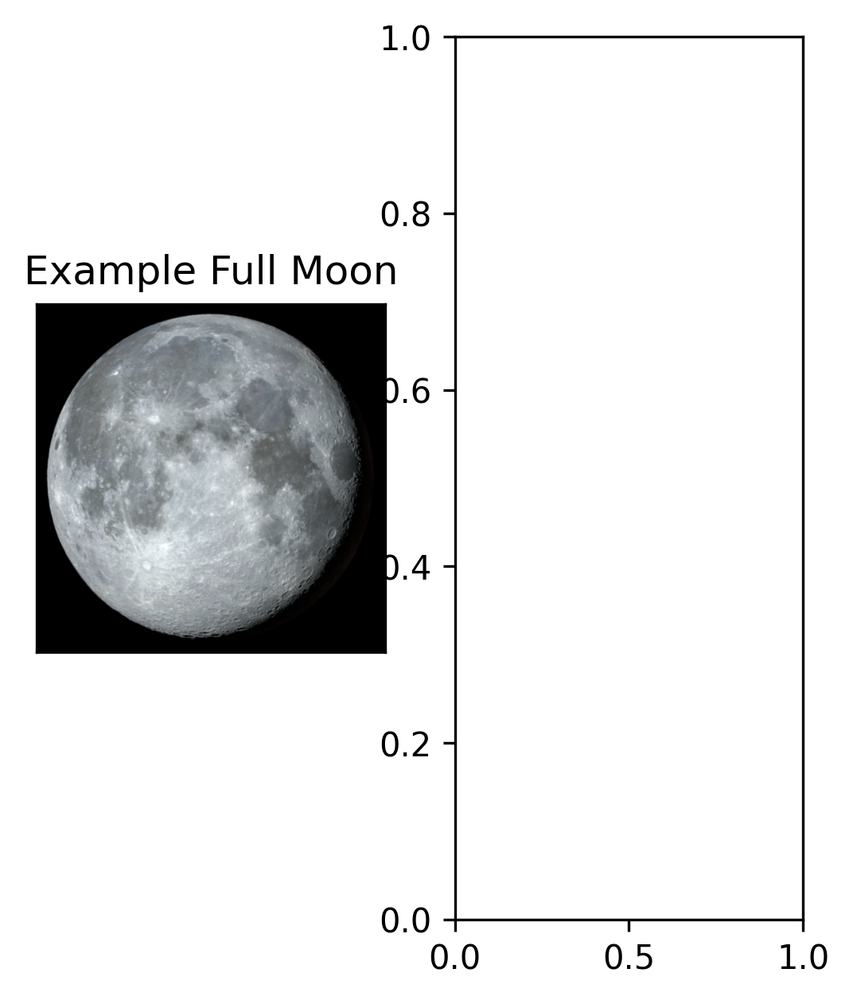

In [9]:
plt.figure()
plt.subplot(1,3,1)
example_img_index = 4
img = (imgs[example_img_index] - np.min(imgs[example_img_index])) / (np.max(imgs[example_img_index]) - np.min(imgs[example_img_index]))  #normalizing image between 0-1 for visualization
plt.imshow(img)
plt.title('Example Full Moon')
plt.xticks([])
plt.yticks([])
#plt.plot([1,2,3,4])
plt.subplot(1,3,2)
#plt.plot([1,2,3,4])
plt.imshow(img_albedo)
plt.title('Image Albedo')
plt.xticks([])
plt.yticks([])
plt.subplot(1,3,3)
#plt.plot([1,2,3,4])
plt.imshow(img_normal_rgb)
plt.title('Surface Normals')
plt.xticks([])
plt.yticks([])
plt.show()

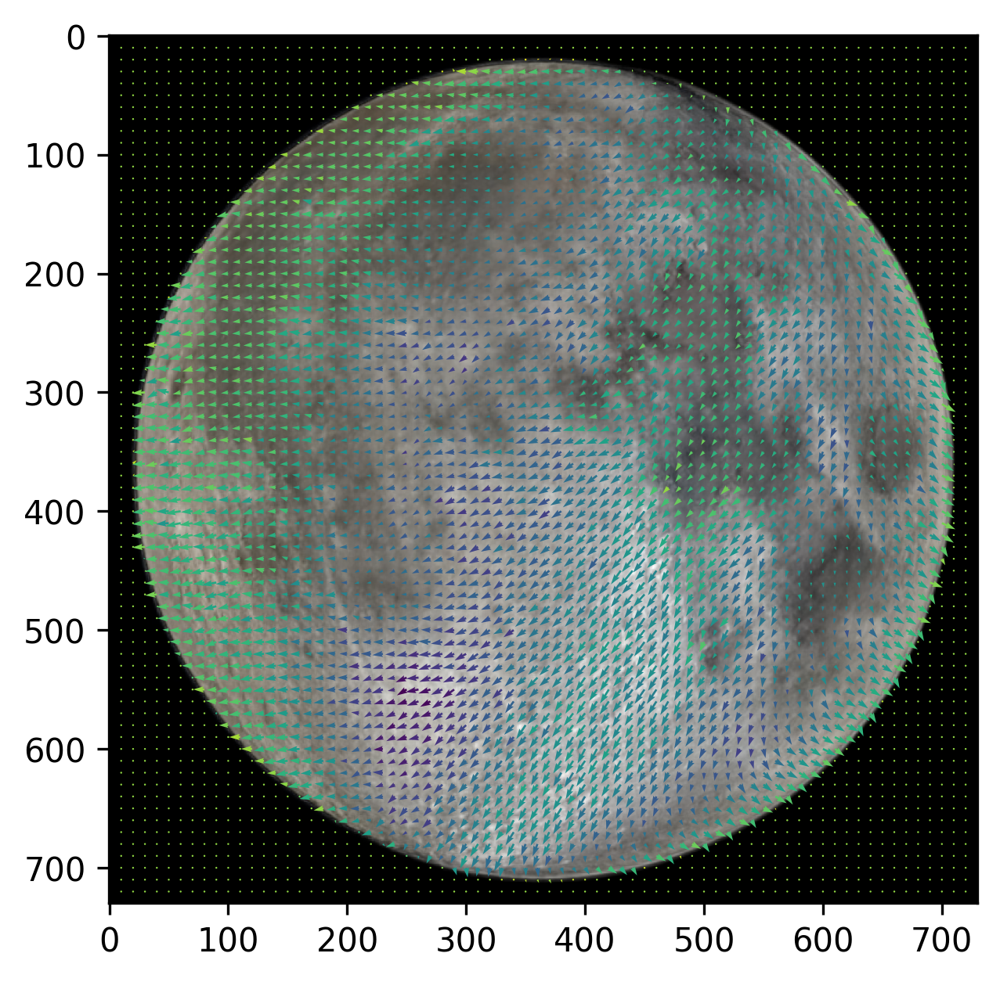

In [4]:
# Graph a new quiver plot with the normals
normals = np.load(f"./output/normals.npy")
plt.figure()
plt.imshow(cv2.cvtColor(cv2.imread("./output/albedo.png"), cv2.COLOR_BGR2RGB))
# plt.quiver(normals[:,:,0], normals[:,:,1], normals[:,:,2])
# x_pos, y_pos = np.meshgrid(np.arange(0, normals.shape[0], 10), np.arange(0, normals.shape[1], 10))
x_pos, y_pos = np.meshgrid(np.arange(0, normals.shape[0], 10), np.arange(0, normals.shape[1], 10))
plt.quiver(y_pos, x_pos, normals[x_pos, y_pos, 0], normals[x_pos, y_pos, 1], normals[x_pos, y_pos, 2])
# plt.imshow(np.abs(normals))
plt.show()

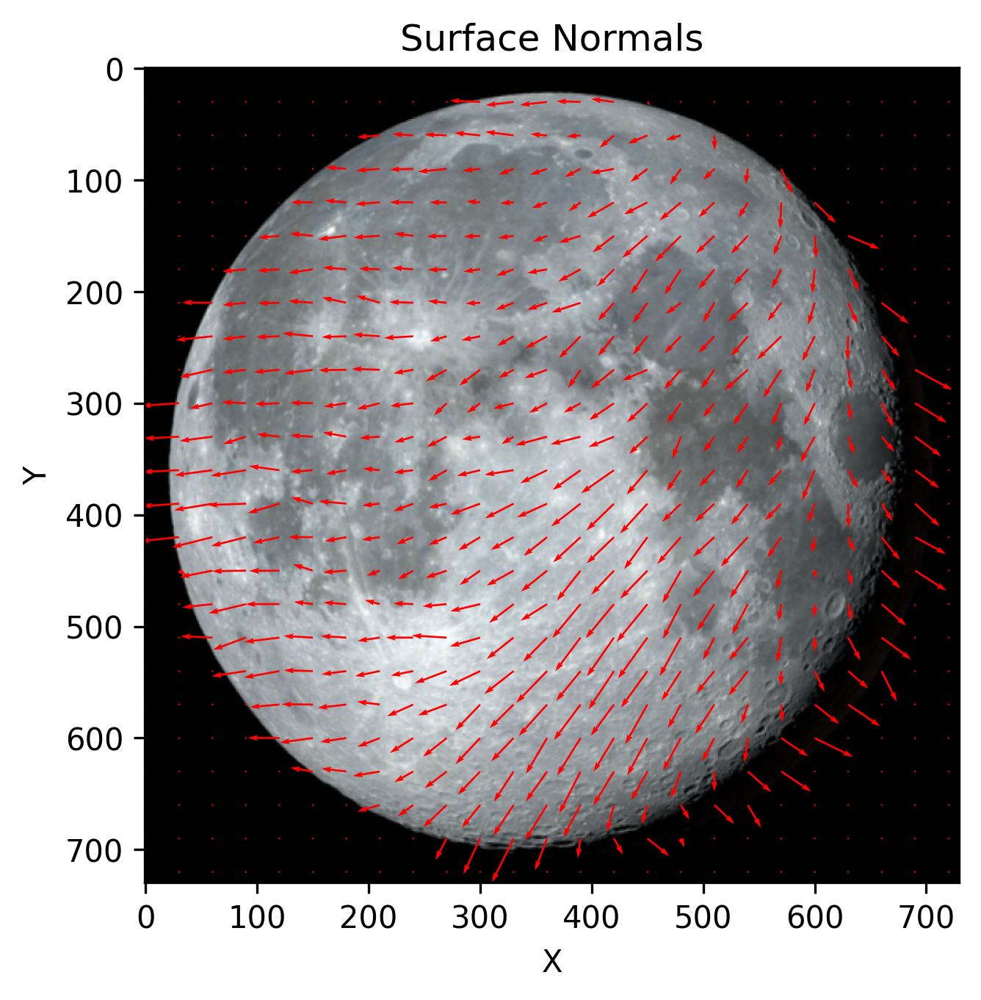

In [35]:
spacing = 30  

x = np.arange(0, 730, spacing)
y = np.arange(0, 730, spacing)
X, Y = np.meshgrid(x, y)

# Extract normal vector components
U = normals[Y, X, 0]  
V = normals[Y, X, 1]

# Plot image   
fig, ax = plt.subplots()
ax.imshow(img)

# Overlay vectors
ax.quiver(X, Y, U, V, color='r')

ax.set_title("Surface Normals")
ax.set_xlabel('X')
ax.set_ylabel('Y')

plt.show()

In [27]:
# np.savetxt("./output/normals.txt", normals.reshape((730 ** 2, 3)))

In [28]:
# # Graph a 3d quiver plot
# from mpl_toolkits.mplot3d import Axes3D
# fig = plt.figure()
# ax = fig.add_subplot(projection='3d')
# x_pos, y_pos, z_pos = np.meshgrid(np.arange(0, N.shape[0], 10), np.arange(0, N.shape[1], 10), np.arange(0, N.shape[2], 10))
# ax.quiver(y_pos, x_pos, z_pos, N[x_pos, y_pos, 1], N[x_pos, y_pos, 0], N[x_pos, y_pos, 2], length=0.01)
# plt.show()

# Everything works up until here ⤴️

In [29]:
# Height map test - not working yet
from heightmap import estimate_height_map
from skimage import io
import plotly.graph_objects as go
NORMAL_MAP_A_PATH: str = "./output/normal_rgb.png"
NORMAL_MAP_A_IMAGE: np.ndarray = io.imread(NORMAL_MAP_A_PATH)
heights = estimate_height_map(NORMAL_MAP_A_IMAGE, raw_values=True)

# figure, axes = plt.subplots(1, 2, figsize=(7, 3))
# _ = axes[0].imshow(NORMAL_MAP_A_IMAGE)
# _ = axes[1].imshow(heights)
print(heights)

x, y = np.meshgrid(range(heights.shape[1]), range(heights.shape[0]))
# _, axes = plt.subplots(1, 1, subplot_kw={"projection": "3d"})
# _ = axes.scatter(x, y, heights, c=heights)
fig = go.Figure(data=[go.Surface(x=x, y=y, z=heights)])
fig.update_layout(title='Moon Height Map', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()

[[-1.38083579 -1.73973017 -1.71072266 ... 10.93262189 10.9114803
   9.01614196]
 [-1.76084781 -1.96624575 -1.9579739  ... 12.45261417 12.43021111
  11.14099722]
 [-1.7708995  -1.98733653 -1.97734993 ... 12.47136264 12.44999016
  10.87561475]
 ...
 [-6.33926926 -7.20493053 -7.2072618  ... -0.61786554 -0.60896829
  -0.52072132]
 [-6.32291824 -7.19208449 -7.19585936 ... -0.62311141 -0.61271222
  -0.53693542]
 [-5.24662993 -6.43601968 -6.28678294 ... -0.55841262 -0.56925939
  -0.42046228]]


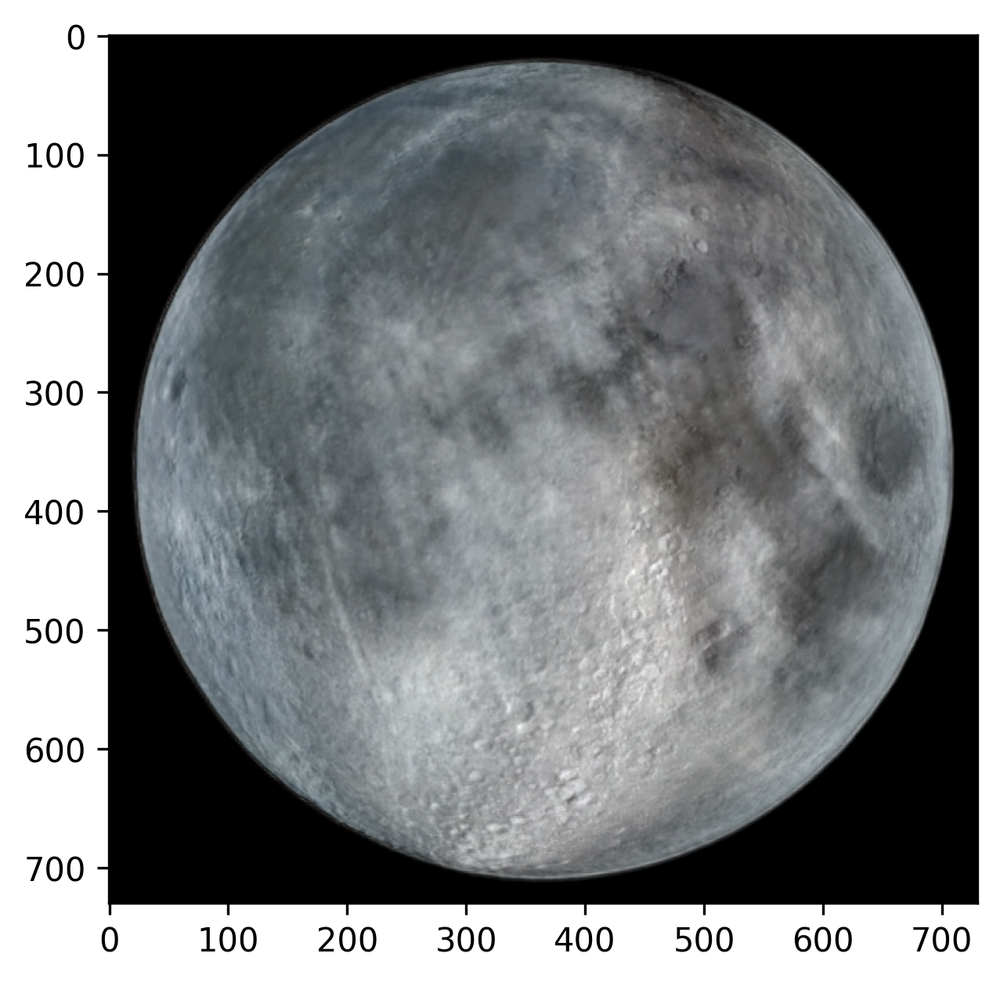

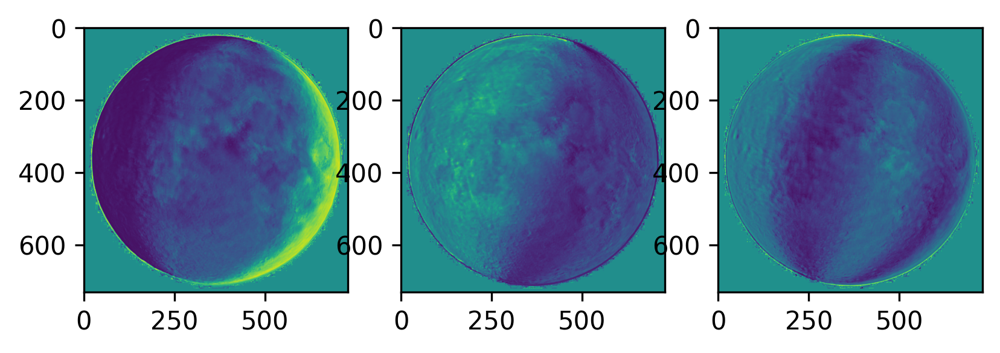

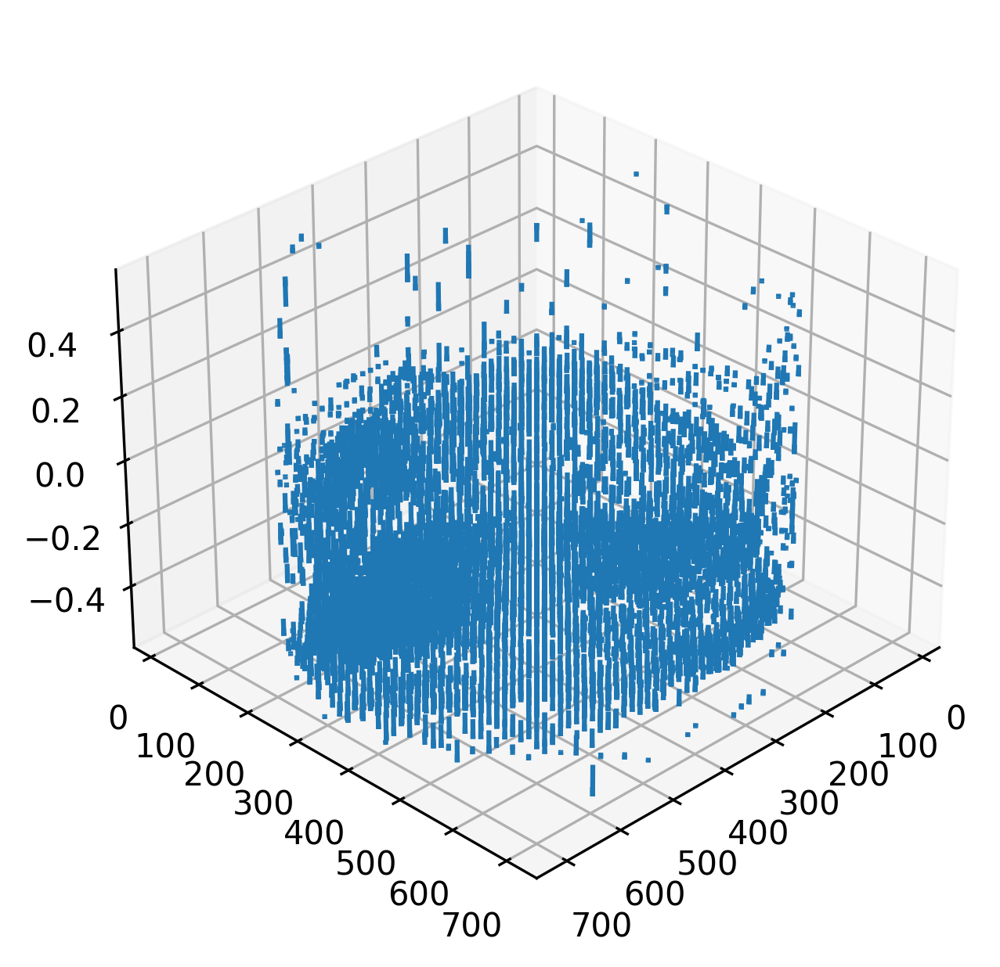

ValueError: Argument Z must be 2-dimensional.

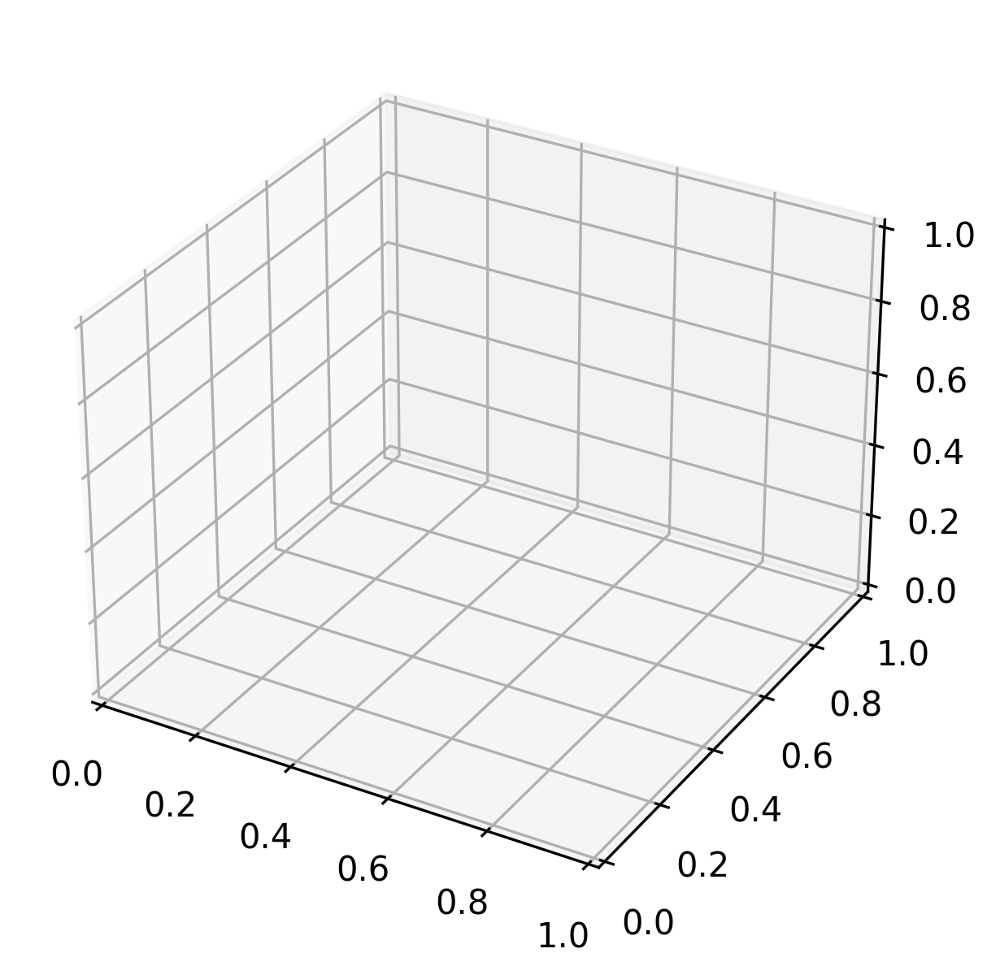

In [30]:
# Experimental visualization vector map?? (not working either)
def visualize(albedo, normals, horn_depth):
    # Stride in the plot, you may want to adjust it to different images
    stride = 15
    # showing albedo map
    fig = plt.figure()
    # albedo_max = albedo.max()
    # albedo = albedo / albedo_max
    plt.imshow(albedo, cmap="gray")
    plt.show()
    # showing normals as three separate channels
    figure = plt.figure()
    ax1 = figure.add_subplot(131)
    ax1.imshow(normals[..., 0])
    ax2 = figure.add_subplot(132)
    ax2.imshow(normals[..., 1])
    ax3 = figure.add_subplot(133)
    ax3.imshow(normals[..., 2])
    plt.show()
    # showing normals as quiver
    X, Y, _ = np.meshgrid(np.arange(0,np.shape(normals)[0], 15),
    np.arange(0,np.shape(normals)[1], 15),
    np.arange(1))
    X = X[..., 0]
    Y = Y[..., 0]
    Z = horn_depth[::stride,::stride].T
    NX = normals[..., 0][::stride,::-stride].T
    NY = normals[..., 1][::-stride,::stride].T
    NZ = normals[..., 2][::stride,::stride].T
    fig = plt.figure(figsize=(5, 5))
    ax = fig.add_subplot(projection='3d')
    ax.view_init(elev=30, azim=45, roll=0)
    plt.quiver(X,Y,Z,NX,NY,NZ, length=0.1, normalize=True)
    # fig2 = go.Figure(data=go.Cone(x=X, y=Y, z=Z, u=NX, v=NY, w=NZ, sizemode="absolute", sizeref=2, anchor="tip"))
    # fig2.update_layout(title='Moon Surface Normals', autosize=False, scene=dict(domain_x=[0, 1], domain_y=[0, 1]))
    # fig2.show()
    plt.show()
    # plotting wireframe depth map
    H = horn_depth[::stride,::stride]
    fig = plt.figure()
    ax = fig.add_subplot(projection='3d')
    ax.plot_surface(X,Y, H.T)
    plt.show()

visualize(img_albedo, img_normal, img_normal)